In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings("ignore")
# import user_functions as uf 
# uf.korean()

# default_path = "../lab10/raw_data/"
# app_train = pd.read_csv(default_path+"application_train.csv")

data = pd.read_csv('./project_data/train_datasets.csv')


In [2]:
y_target = data[['TARGET']]
X_features = data.drop(columns=['Unnamed: 0','SK_ID_CURR','TARGET'])

In [3]:
X_features.rename(columns = {"승인/거부(prev_app)": "Approve_reject_prev_app", "(추정)이자율":"estimated_interest_rate",
                             "연체일": "overdue_date",
                            "연체횟수":"number_of_overdue", "승인액/요청액":"Approval_amount_request_amount",
                            "과거_상환액/총액":"Past_Payment_Amount_Total", "연체기간(pos_cash)":"Overdue_period_pos_cash)",
                            "소액연체비중(pos_cash)":"Share_of_small_delinquency_pos_cash",
                            '거주지일치여부':'Residence_match', '주변인채무':'Neighbors_Debt', 'CB문의':'CB_inquiry',
                            '서류여부':'Whether_documents'}, inplace=True)


In [4]:
import re
X_features = X_features.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))


In [6]:
# LigtGMB
from lightgbm import LGBMClassifier

# 학습/테스트 데이터 세트 분리
X_train , X_test , y_train , y_test = train_test_split(X_features , y_target, test_size=0.2, 
                                                       stratify=y_target, random_state=2021)
print(X_train.shape, X_test.shape)

(243075, 142) (60769, 142)


In [8]:
#-------------------------------------------------------------------------------------------------
# 모델과 하이퍼 파라미터값을 전달 받아서
# 최적화 작업의 결과를 표시하는 함수 작성
# 릿지와 라쏘 모델의 최적화 alpha 값 추출
from sklearn.model_selection import GridSearchCV
def get_best_params(model, params):
    grid_model = GridSearchCV(model, param_grid=params, scoring='neg_mean_squared_error', cv=5)
    grid_model.fit(X_features, y_target)
    
    rmse = np.sqrt(-1*grid_model.best_score_)
    
    print('{0} 5 CV 시 최적 평균 RMSE 값 :{1}, 최적 alpha {2}'.format(model.__class__.__name__, 
                                                                np.round(rmse, 4),
                                                               grid_model.best_params_))
    
    return grid_model.best_estimator_
#-------------------------------------------------------------------------------------------------


from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.metrics import precision_score, recall_score
from sklearn.metrics import f1_score, roc_auc_score

# 수정된 get_clf_eval() 함수 
def get_clf_eval(y_test, pred=None, pred_proba=None):
    confusion = confusion_matrix( y_test, pred)
    accuracy = accuracy_score(y_test , pred)
    precision = precision_score(y_test , pred)
    recall = recall_score(y_test , pred)
    f1 = f1_score(y_test,pred)
    # ROC-AUC 추가 
    roc_auc = roc_auc_score(y_test, pred_proba)
    print('오차 행렬')
    print(confusion)
    # ROC-AUC print 추가
    print('정확도: {0:.4f}, 정밀도: {1:.4f}, 재현율: {2:.4f},\
    F1: {3:.4f}, AUC:{4:.4f}'.format(accuracy, precision, recall, f1, roc_auc))
    
    
    # 앞에서 사용한 것 그대로 복사해서 사용

import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
from sklearn.metrics import precision_recall_curve
%matplotlib inline

def precision_recall_curve_plot(y_test , pred_proba_c1):
    # threshold ndarray와 이 threshold에 따른 정밀도, 재현율 ndarray 추출. 
    precisions, recalls, thresholds = precision_recall_curve( y_test, pred_proba_c1)
    
    # X축을 threshold값으로, Y축은 정밀도, 재현율 값으로 각각 Plot 수행. 정밀도는 점선으로 표시
    plt.figure(figsize=(8,6))
    threshold_boundary = thresholds.shape[0]
    plt.plot(thresholds, precisions[0:threshold_boundary], linestyle='--', label='precision')
    plt.plot(thresholds, recalls[0:threshold_boundary],label='recall')
    
    # threshold 값 X 축의 Scale을 0.1 단위로 변경
    start, end = plt.xlim()
    plt.xticks(np.round(np.arange(start, end, 0.1),2))
    
    # x축, y축 label과 legend, 그리고 grid 설정
    plt.xlabel('Threshold value'); plt.ylabel('Precision and Recall value')
    plt.legend(); plt.grid()
    plt.show()
    
    



In [ ]:
def roc_curve_plot(y_test , pred_proba_c1):
    # 임곗값에 따른 FPR, TPR 값을 반환 받음. 
    fprs , tprs , thresholds = roc_curve(y_test ,pred_proba_c1)

    # ROC Curve를 plot 곡선으로 그림. 
    plt.plot(fprs , tprs, label='ROC')
    # 가운데 대각선 직선을 그림. 
    plt.plot([0, 1], [0, 1], 'k--', label='Random')
    
    # FPR X 축의 Scale을 0.1 단위로 변경, X,Y 축명 설정등   
    start, end = plt.xlim()
    plt.xticks(np.round(np.arange(start, end, 0.1),2))
    plt.xlim(0,1); plt.ylim(0,1)
    plt.xlabel('FPR( 1 - Sensitivity )'); plt.ylabel('TPR( Recall )')
    plt.legend()
    plt.show()
    
roc_curve_plot(y_test, pred_proba[:, 1] )


#그래프 설명
# 일반적으로 곡선 자체는 FPR과 TRP의 변화값을 보든데 이용하고
# 분류의 성능 지표로 사용되는 것은 ROC 곡선 면적에 기반한 AUC 값으로 결정
# AUC(Area Under Curve) 값은 ROC 곡선 밑의 면적을 구한 것으로
# 일반적으로 1에 가까울수록 좋음

# AUC 수치가 커지려면 FPR이 작은 상태에서 얼마나 큰 TPR을 얻을 수 있느냐가 관건
# 가운데 직선에서 멀어지고 왼쪽 상단 모서리쪽으로 가파르게 곡선이 이동할수록
# 직사각형에 가까운 곡선이 되어 면적이 1에 가까워지는
# 좋은 ROC AUC 성능 수치를 얻게 됨
# 가운데 직선은 랜덤 수준의 이진 분류 AUC값으로 0.5
# 따라서 보통의 분류는 0.5 이상의 AUC값을 가짐

## LGBMClassifier(base)
오차 행렬
[[55764   112]
 [ 4748   145]]
정확도: 0.9200, 정밀도: 0.5642, 재현율: 0.0296,    F1: 0.0563, AUC:0.7651


In [9]:
lgbm_wrapper = LGBMClassifier(n_estimators=400)

evals = [(X_test, y_test)]
lgbm_wrapper.fit(X_train, y_train, early_stopping_rounds=100, 
                 eval_metric="logloss",
                eval_set=evals, verbose=True)
wrapper_preds = lgbm_wrapper.predict(X_test)
wrapper_pred_proba = lgbm_wrapper.predict_proba(X_test)[:, 1]

[1]	valid_0's binary_logloss: 0.275042
Training until validation scores don't improve for 100 rounds
[2]	valid_0's binary_logloss: 0.271311
[3]	valid_0's binary_logloss: 0.268389
[4]	valid_0's binary_logloss: 0.266049
[5]	valid_0's binary_logloss: 0.263816
[6]	valid_0's binary_logloss: 0.26213
[7]	valid_0's binary_logloss: 0.260583
[8]	valid_0's binary_logloss: 0.2591
[9]	valid_0's binary_logloss: 0.25794
[10]	valid_0's binary_logloss: 0.256879
[11]	valid_0's binary_logloss: 0.256017
[12]	valid_0's binary_logloss: 0.255204
[13]	valid_0's binary_logloss: 0.254386
[14]	valid_0's binary_logloss: 0.253666
[15]	valid_0's binary_logloss: 0.253111
[16]	valid_0's binary_logloss: 0.252611
[17]	valid_0's binary_logloss: 0.252151
[18]	valid_0's binary_logloss: 0.251592
[19]	valid_0's binary_logloss: 0.251161
[20]	valid_0's binary_logloss: 0.250757
[21]	valid_0's binary_logloss: 0.250359
[22]	valid_0's binary_logloss: 0.249864
[23]	valid_0's binary_logloss: 0.249522
[24]	valid_0's binary_logloss: 

ROC AUC 값 : 0.7651


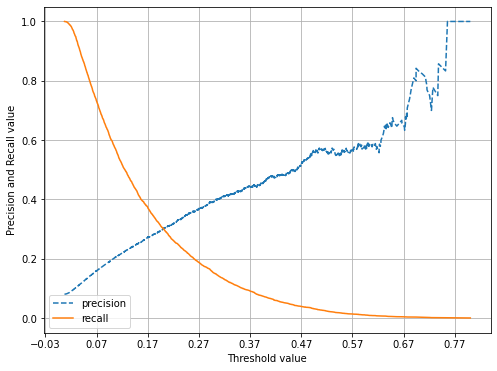

In [14]:
# ROC AUC 값 확인

from sklearn.metrics import roc_auc_score

pred_proba = lgbm_wrapper.predict_proba(X_test)[:, 1]
roc_score = roc_auc_score(y_test, pred_proba)
print('ROC AUC 값 : {0:.4f}'.format(roc_score))

precision_recall_curve_plot(y_test, lgbm_wrapper.predict_proba(X_test)[:, 1])


In [10]:
get_clf_eval(y_test, wrapper_preds, wrapper_pred_proba)

오차 행렬
[[55764   112]
 [ 4748   145]]
정확도: 0.9200, 정밀도: 0.5642, 재현율: 0.0296,    F1: 0.0563, AUC:0.7651


In [21]:
print("Feature importance :\n{0}"
      .format(np.round(lgbm_wrapper.feature_importances_,3)))


Feature importance :
[ 20  27   2   4  86 178 143 111  48  69 193 123 121 124  45   8   0  29
 193 192 194 100 101  12   0 118 141  41  10  83  59   7  83 129 128  32
  36   2  20  49  46  22  29  22   1   0   1   1   0   0   0   2   1  10
   0   0  14   5  27   3   5   1   2   1   4   3   3   7   0   1   5   8
   0   7   2   4   7   2   1   0   1   6   0   1   1   0   2   4   0   1
   8   0   8   0   0   1   0   1   2   0   0   1   0   0   0   2   1   0
   0   1   2   0   4   1   2   5   0   0   3   2   3   0   2   7   1   2
  15   1   2   0   0   1   0   0   0   2   0   0  14   2   0   0]


<AxesSubplot:title={'center':'Feature importance'}, xlabel='Feature importance', ylabel='Features'>

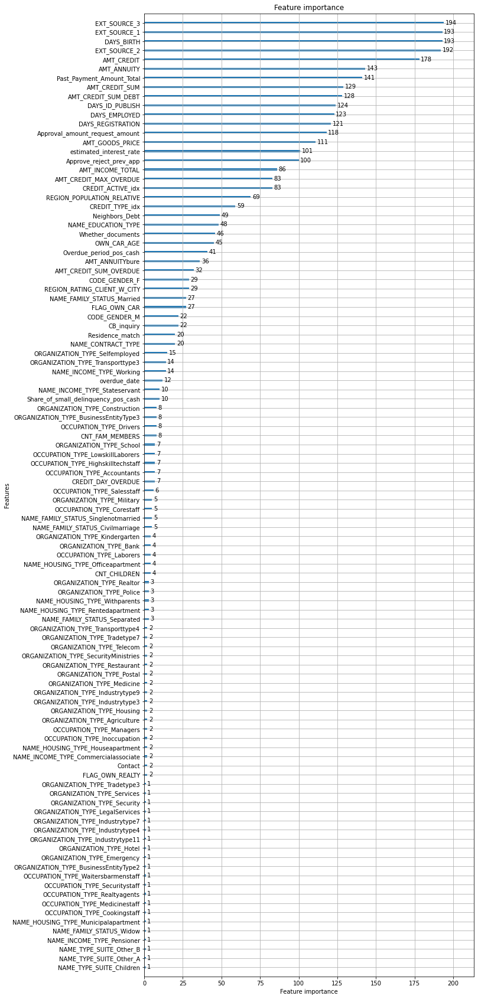

In [15]:
from lightgbm import plot_importance
import matplotlib.pyplot as plt
%matplotlib inline

fig, ax = plt.subplots(figsize=(10, 30))
plot_importance(lgbm_wrapper, ax=ax)

## LGBMClassifier(n_estimators=1000)
오차 행렬
[[55769   107]
 [ 4750   143]]
정확도: 0.9201, 정밀도: 0.5720, 재현율: 0.0292,    F1: 0.0556, \
AUC:0.7652

In [22]:
from lightgbm import LGBMClassifier

lgbm_clf = LGBMClassifier(n_estimators=1000)

evals = [(X_test, y_test)]
lgbm_clf.fit(X_train, y_train, early_stopping_rounds=100, 
             eval_metric="auc", eval_set=evals,
            verbose=True)

lgbm_roc_score = roc_auc_score(y_test, lgbm_clf.predict_proba(X_test)
                               [:,1], average='macro')
print('ROC AUC:{0:.4f}'.format(lgbm_roc_score))

# ROC AUC:0.7652


[1]	valid_0's auc: 0.705365	valid_0's binary_logloss: 0.275042
Training until validation scores don't improve for 100 rounds
[2]	valid_0's auc: 0.713977	valid_0's binary_logloss: 0.271311
[3]	valid_0's auc: 0.717764	valid_0's binary_logloss: 0.268389
[4]	valid_0's auc: 0.719674	valid_0's binary_logloss: 0.266049
[5]	valid_0's auc: 0.72392	valid_0's binary_logloss: 0.263816
[6]	valid_0's auc: 0.727288	valid_0's binary_logloss: 0.26213
[7]	valid_0's auc: 0.729012	valid_0's binary_logloss: 0.260583
[8]	valid_0's auc: 0.731686	valid_0's binary_logloss: 0.2591
[9]	valid_0's auc: 0.733502	valid_0's binary_logloss: 0.25794
[10]	valid_0's auc: 0.735019	valid_0's binary_logloss: 0.256879
[11]	valid_0's auc: 0.736395	valid_0's binary_logloss: 0.256017
[12]	valid_0's auc: 0.737548	valid_0's binary_logloss: 0.255204
[13]	valid_0's auc: 0.739254	valid_0's binary_logloss: 0.254386
[14]	valid_0's auc: 0.740527	valid_0's binary_logloss: 0.253666
[15]	valid_0's auc: 0.741233	valid_0's binary_logloss: 0

In [23]:
preds = lgbm_clf.predict(X_test)
pred_proba = lgbm_clf.predict_proba(X_test)[:, 1]

In [24]:
get_clf_eval(y_test, preds, pred_proba)

오차 행렬
[[55769   107]
 [ 4750   143]]
정확도: 0.9201, 정밀도: 0.5720, 재현율: 0.0292,    F1: 0.0556, AUC:0.7652


In [25]:
from sklearn.model_selection import GridSearchCV

# 하이퍼 파라미터 수행속도 향상을 위한다면 estimator 수치 조정
lgbm_clf = LGBMClassifier(n_estimators=100)

params = {'num_leaves' :[32, 64],
         'max_depth':[128, 160],
         'min_child_samples':[60, 100],
         'subsample':[0.8, 1]}

# cv는 5로 지정
gridcv = GridSearchCV(lgbm_clf, param_grid=params, cv=5)
gridcv.fit(X_train, y_train,eval_metric="auc", eval_set=[(X_train, y_train), (X_test, y_test)])

print('GridSearchCV 최적 파라미터 :', gridcv.best_params_)
lgbm_roc_score = roc_auc_score(y_test, gridcv.predict_proba(X_test[:,1], average='macro'))
print('ROC AUC:{0:.4f}'.format(lgbm_roc_score))

[1]	valid_0's auc: 0.706955	valid_0's binary_logloss: 0.274983	valid_1's auc: 0.704544	valid_1's binary_logloss: 0.275022
[2]	valid_0's auc: 0.716327	valid_0's binary_logloss: 0.271069	valid_1's auc: 0.712629	valid_1's binary_logloss: 0.271288
[3]	valid_0's auc: 0.722678	valid_0's binary_logloss: 0.268067	valid_1's auc: 0.718944	valid_1's binary_logloss: 0.268361
[4]	valid_0's auc: 0.726641	valid_0's binary_logloss: 0.26546	valid_1's auc: 0.722767	valid_1's binary_logloss: 0.265853
[5]	valid_0's auc: 0.729701	valid_0's binary_logloss: 0.26335	valid_1's auc: 0.725813	valid_1's binary_logloss: 0.263806
[6]	valid_0's auc: 0.731333	valid_0's binary_logloss: 0.261491	valid_1's auc: 0.72735	valid_1's binary_logloss: 0.262085
[7]	valid_0's auc: 0.732982	valid_0's binary_logloss: 0.259942	valid_1's auc: 0.729119	valid_1's binary_logloss: 0.260591
[8]	valid_0's auc: 0.735523	valid_0's binary_logloss: 0.258414	valid_1's auc: 0.731241	valid_1's binary_logloss: 0.259165
[9]	valid_0's auc: 0.73772	

TypeError: '(slice(None, None, None), 1)' is an invalid key

In [26]:
print('GridSearchCV 최적 파라미터 :', gridcv.best_params_)
lgbm_roc_score = roc_auc_score(y_test, gridcv.predict_proba(X_test)[:,1], average='macro')
print('ROC AUC:{0:.4f}'.format(lgbm_roc_score))

GridSearchCV 최적 파라미터 : {'max_depth': 128, 'min_child_samples': 60, 'num_leaves': 64, 'subsample': 0.8}
ROC AUC:0.7646


In [31]:
#
lgbm_clf_hyper_1 = LGBMClassifier(n_estimators=4000,max_depth = 128, num_leaves=64,subsample=0.8)

evals = [(X_test, y_test)]
lgbm_clf_hyper_1.fit(X_train, y_train, early_stopping_rounds=500, eval_metric="auc", eval_set=evals,
            verbose=True)

lgbm_roc_score = roc_auc_score(y_test, lgbm_clf_hyper_1.predict_proba(X_test)[:, 1], average='macro')

print('ROC AUC:{0:.4f}'.format(lgbm_roc_score))

[1]	valid_0's auc: 0.710689	valid_0's binary_logloss: 0.274583
Training until validation scores don't improve for 500 rounds
[2]	valid_0's auc: 0.719912	valid_0's binary_logloss: 0.270614
[3]	valid_0's auc: 0.721791	valid_0's binary_logloss: 0.267605
[4]	valid_0's auc: 0.724004	valid_0's binary_logloss: 0.265135
[5]	valid_0's auc: 0.728761	valid_0's binary_logloss: 0.262807
[6]	valid_0's auc: 0.731315	valid_0's binary_logloss: 0.261109
[7]	valid_0's auc: 0.733377	valid_0's binary_logloss: 0.259585
[8]	valid_0's auc: 0.73556	valid_0's binary_logloss: 0.258104
[9]	valid_0's auc: 0.73694	valid_0's binary_logloss: 0.256897
[10]	valid_0's auc: 0.73817	valid_0's binary_logloss: 0.255817
[11]	valid_0's auc: 0.739603	valid_0's binary_logloss: 0.254922
[12]	valid_0's auc: 0.740942	valid_0's binary_logloss: 0.254046
[13]	valid_0's auc: 0.742002	valid_0's binary_logloss: 0.253365
[14]	valid_0's auc: 0.743298	valid_0's binary_logloss: 0.252625
[15]	valid_0's auc: 0.743924	valid_0's binary_logloss:

In [28]:
preds_hyper_1 = lgbm_clf_hyper_1.predict(X_test)
pred_proba_hyper_1 = lgbm_clf_hyper_1.predict_proba(X_test)[:, 1]
get_clf_eval(y_test, preds_hyper_1, pred_proba_hyper_1)

오차 행렬
[[55757   119]
 [ 4752   141]]
정확도: 0.9198, 정밀도: 0.5423, 재현율: 0.0288,    F1: 0.0547, AUC:0.7641


In [48]:
from sklearn.model_selection import GridSearchCV

# 하이퍼 파라미터 수행속도 향상을 위한다면 estimator 수치 조정
lgbm_clf = LGBMClassifier(n_estimators=100)

params = {'learning_rate': [0, 0.01, 0.02],
          'max_depth' : [10,11,12],
          'num_leaves': [57, 58, 59],
            'colsample_bytree':[0.613,0.614,0.615],
            'subsample':[0.708,0.709,0.71],
            'max_bin':[406,407,408],
            'reg_alpha':[3.564,3.564,3.565],
            'reg_lambda':[4.930,4.94,4.95],
            'min_child_weight': [6,7,8],
            'min_child_samples':[164,165]}

# cv는 2로 지정
gridcv = GridSearchCV(lgbm_clf, param_grid=params, cv=2)
gridcv.fit(X_train, y_train,eval_metric="auc", 
           eval_set=[(X_train, y_train), (X_test, y_test)])

print('GridSearchCV 최적 파라미터 :', gridcv.best_params_)
lgbm_roc_score = roc_auc_score(y_test, 
                               gridcv.predict_proba(X_test[:,1], 
                                                    average='macro'))
print('ROC AUC:{0:.4f}'.format(lgbm_roc_score))

[1]	valid_0's auc: 0.713231	valid_0's binary_logloss: 0.279496	valid_1's auc: 0.704988	valid_1's binary_logloss: 0.27952
[2]	valid_0's auc: 0.724808	valid_0's binary_logloss: 0.279262	valid_1's auc: 0.709196	valid_1's binary_logloss: 0.279317
[3]	valid_0's auc: 0.732903	valid_0's binary_logloss: 0.278854	valid_1's auc: 0.719588	valid_1's binary_logloss: 0.278925
[4]	valid_0's auc: 0.736074	valid_0's binary_logloss: 0.278354	valid_1's auc: 0.723852	valid_1's binary_logloss: 0.278446
[5]	valid_0's auc: 0.737633	valid_0's binary_logloss: 0.277947	valid_1's auc: 0.726241	valid_1's binary_logloss: 0.27805
[6]	valid_0's auc: 0.740718	valid_0's binary_logloss: 0.277721	valid_1's auc: 0.72858	valid_1's binary_logloss: 0.277849
[7]	valid_0's auc: 0.74618	valid_0's binary_logloss: 0.277352	valid_1's auc: 0.733793	valid_1's binary_logloss: 0.277508
[8]	valid_0's auc: 0.747545	valid_0's binary_logloss: 0.277104	valid_1's auc: 0.733817	valid_1's binary_logloss: 0.277285
[9]	valid_0's auc: 0.748212	

KeyboardInterrupt: 

In [ ]:
print('GridSearchCV 최적 파라미터 :', gridcv.best_params_)
lgbm_roc_score = roc_auc_score(y_test, gridcv.predict_proba(X_test)[:,1], average='macro')
print('ROC AUC:{0:.4f}'.format(lgbm_roc_score))

## LGBMClassifier(파라미터값 지정)
오차 행렬
[[55738   138]
 [ 4732   161]]
정확도: 0.9199, 정밀도: 0.5385, 재현율: 0.0329,    F1: 0.0620, \
#### AUC:0.7709


In [49]:
#
lgbm_clf = LGBMClassifier(n_estimators=4000,
                learning_rate=0.01,
                max_depth = 11,
                num_leaves=58,
                colsample_bytree=0.613,
                subsample=0.708,
                max_bin=407,
                reg_alpha=3.564,
                reg_lambda=4.930,
                min_child_weight= 6,
                min_child_samples=165,
                silent=-1,
                verbose=-1)

evals = [(X_test, y_test)]
lgbm_clf.fit(X_train, y_train, early_stopping_rounds=500, 
             eval_metric="auc", eval_set=evals,
            verbose=True)

lgbm_roc_score = roc_auc_score(y_test, 
                               lgbm_clf.predict_proba(X_test)[:, 1], 
                               average='macro')

print('ROC AUC:{0:.4f}'.format(lgbm_roc_score))

# ROC AUC:0.7709

[1]	valid_0's auc: 0.685732	valid_0's binary_logloss: 0.279626
Training until validation scores don't improve for 500 rounds
[2]	valid_0's auc: 0.697343	valid_0's binary_logloss: 0.279203
[3]	valid_0's auc: 0.706045	valid_0's binary_logloss: 0.278917
[4]	valid_0's auc: 0.727897	valid_0's binary_logloss: 0.2785
[5]	valid_0's auc: 0.735712	valid_0's binary_logloss: 0.277978
[6]	valid_0's auc: 0.733826	valid_0's binary_logloss: 0.277586
[7]	valid_0's auc: 0.733794	valid_0's binary_logloss: 0.277327
[8]	valid_0's auc: 0.738243	valid_0's binary_logloss: 0.276863
[9]	valid_0's auc: 0.740397	valid_0's binary_logloss: 0.276401
[10]	valid_0's auc: 0.738733	valid_0's binary_logloss: 0.276036
[11]	valid_0's auc: 0.739479	valid_0's binary_logloss: 0.275579
[12]	valid_0's auc: 0.739677	valid_0's binary_logloss: 0.275137
[13]	valid_0's auc: 0.739728	valid_0's binary_logloss: 0.274702
[14]	valid_0's auc: 0.740986	valid_0's binary_logloss: 0.27435
[15]	valid_0's auc: 0.741743	valid_0's binary_logloss:

In [50]:
preds = lgbm_clf.predict(X_test)
pred_proba = lgbm_clf.predict_proba(X_test)[:, 1]

In [51]:
get_clf_eval(y_test, preds, pred_proba)

오차 행렬
[[55738   138]
 [ 4732   161]]
정확도: 0.9199, 정밀도: 0.5385, 재현율: 0.0329,    F1: 0.0620, AUC:0.7709


<AxesSubplot:title={'center':'Feature importance'}, xlabel='Feature importance', ylabel='Features'>

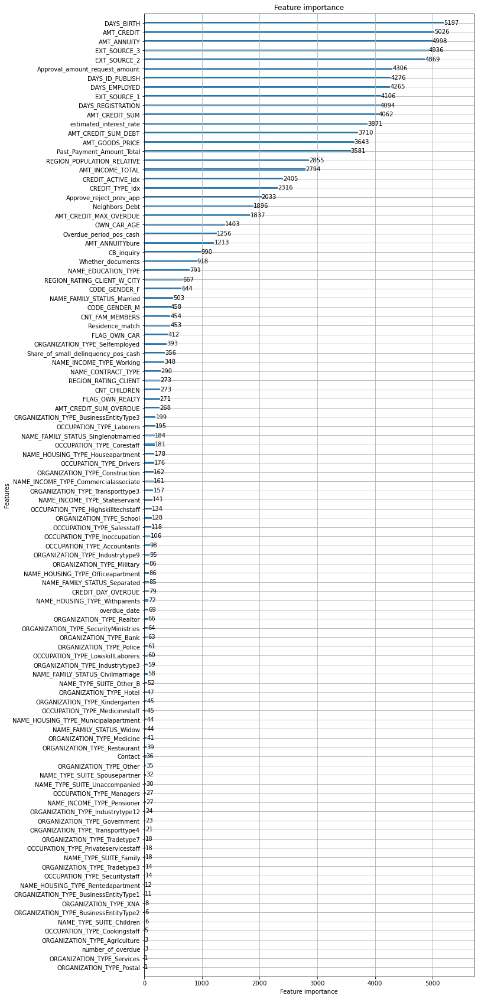

In [52]:
from lightgbm import plot_importance
import matplotlib.pyplot as plt
%matplotlib inline

fig, ax = plt.subplots(figsize=(10, 30))
plot_importance(lgbm_clf, ax=ax)



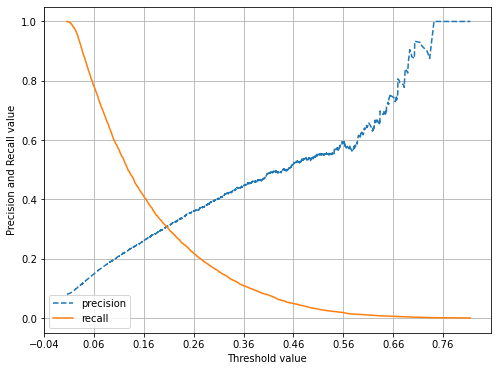

In [53]:
precision_recall_curve_plot(y_test,lgbm_clf.predict_proba(X_test)[:, 1])

## LGBMRegressor

In [37]:
from sklearn.model_selection import GridSearchCV

def get_best_params(model, params):
    grid_model = GridSearchCV(model, param_grid=params, scoring='neg_mean_squared_error', cv=5)
    grid_model.fit(X_train, y_train)
    rmse = np.sqrt(-1* grid_model.best_score_)
    print('최적 평균 RMSE 값:', np.round(rmse, 4))
    print('최적 파라미터:', grid_model.best_params_)
    
    return grid_model.best_estimator_

In [38]:
from lightgbm import LGBMRegressor

# lgbm_params 값을 바꾸어주며 learning_rate, max_depth 등 파라미터 성능 비교 시도했었음.
lgbm_params = {'n_estimators':[3300]}

lgbm_reg = LGBMRegressor(n_estimators=3300, bagging_fraction=0.7, learning_rate=0.1,
                         max_depth=4, subsample=0.7, feature_fraction=0.9, boosting_type='gbdt',
                         colsample_bytree=0.5, reg_lambda=5, n_jobs=-1)

best_lgbm = get_best_params(lgbm_reg, lgbm_params)

[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.5 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=0.7 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.5 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=0.7 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.5 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=0.7 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.5 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=0.7 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] feature_fractio

In [39]:
best_lgbm

LGBMRegressor(bagging_fraction=0.7, colsample_bytree=0.5, feature_fraction=0.9,
              max_depth=4, n_estimators=3300, reg_lambda=5, subsample=0.7)

In [40]:
lgbm_params

{'n_estimators': [3300]}

In [41]:
evals = [(X_test, y_test)]
best_lgbm.fit(X_train, y_train, early_stopping_rounds=500, eval_metric="auc", eval_set=evals,
            verbose=True)

lgbm_roc_score = roc_auc_score(y_test, lgbm_clf.predict_proba(X_test)[:, 1], average='macro')

print('ROC AUC:{0:.4f}'.format(lgbm_roc_score))

[1]	valid_0's auc: 0.674784	valid_0's l2: 0.073604
Training until validation scores don't improve for 500 rounds
[2]	valid_0's auc: 0.711175	valid_0's l2: 0.0730329
[3]	valid_0's auc: 0.714441	valid_0's l2: 0.0725677
[4]	valid_0's auc: 0.719429	valid_0's l2: 0.0721321
[5]	valid_0's auc: 0.720867	valid_0's l2: 0.0717652
[6]	valid_0's auc: 0.72207	valid_0's l2: 0.0714646
[7]	valid_0's auc: 0.724336	valid_0's l2: 0.0711651
[8]	valid_0's auc: 0.724919	valid_0's l2: 0.0709496
[9]	valid_0's auc: 0.726405	valid_0's l2: 0.0707372
[10]	valid_0's auc: 0.727316	valid_0's l2: 0.0705522
[11]	valid_0's auc: 0.728282	valid_0's l2: 0.0703959
[12]	valid_0's auc: 0.729309	valid_0's l2: 0.070262
[13]	valid_0's auc: 0.731439	valid_0's l2: 0.0701301
[14]	valid_0's auc: 0.732001	valid_0's l2: 0.0700178
[15]	valid_0's auc: 0.7333	valid_0's l2: 0.0699278
[16]	valid_0's auc: 0.734045	valid_0's l2: 0.0698237
[17]	valid_0's auc: 0.735248	valid_0's l2: 0.0697375
[18]	valid_0's auc: 0.736411	valid_0's l2: 0.069653

<AxesSubplot:title={'center':'Feature importance'}, xlabel='Feature importance', ylabel='Features'>

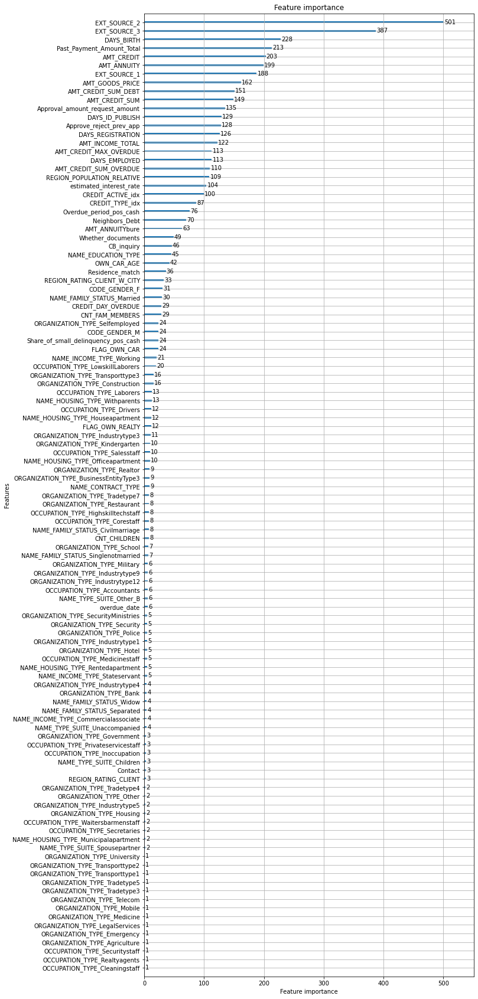

In [42]:
from lightgbm import plot_importance
import matplotlib.pyplot as plt
%matplotlib inline

fig, ax = plt.subplots(figsize=(10, 30))
plot_importance(best_lgbm, ax=ax)

## SMOTE 적용


In [43]:
from imblearn.over_sampling import SMOTE

smote = SMOTE(random_state=0)

# train 데이터 셋으로 들어오는 값들에 대해서 오버 샘플링
# 타깃값의 분포에 맞춰 피처값 생성
X_train_over, y_train_over = smote.fit_resample(X_train, y_train)

In [44]:
print('SMOT 적용 전 학습용 피처/레이블 데이터 세트 : ', 
      X_train.shape, y_train.shape)
print('SMOT 적용 후 학습용 피처/레이블 데이터 세트 : ', 
      X_train_over.shape, y_train_over.shape)



# 결과
# 적용 후 train 데이터가 많이 늘어남
# 적용 후 레이블 값 두개가 동일 : (증식 되었음)

SMOT 적용 전 학습용 피처/레이블 데이터 세트 :  (243075, 142) (243075, 1)
SMOT 적용 후 학습용 피처/레이블 데이터 세트 :  (447006, 142) (447006, 1)


In [45]:
y_train_over.value_counts()


TARGET
0.0       223503
1.0       223503
dtype: int64

In [54]:
# LightGBM 모델 적용
lgbm_clf_over = LGBMClassifier(n_estimators=4000,
                learning_rate=0.01,
                max_depth = 11,
                num_leaves=58,
                colsample_bytree=0.613,
                subsample=0.708,
                max_bin=407,
                reg_alpha=3.564,
                reg_lambda=4.930,
                min_child_weight= 6,
                min_child_samples=165,
                silent=-1,
                verbose=-1)


get_model_train_eval(lgbm_clf_over, ftr_train=X_train_over, ftr_test=X_test, tgr_train=y_train_over, tgt_test=y_test)

# 결과


NameError: name 'get_model_train_eval' is not defined

In [ ]:
precision_recall_curve_plot(y_test,lgbm_clf_over.predict_proba(X_test)[:, 1])